Based on notebook by [pedrogengo](https://github.com/pedrogengo).

# Colab Setup

In [ ]:
!git clone https://github.com/cloneofsimo/lora.git
!sed -i 's/logging_dir=logging_dir/project_dir=logging_dir/g' ./lora/training_scripts/train_lora_dreambooth.py
# https://github.com/huggingface/accelerate/issues/1559
!pip3 install ./lora accelerate bitsandbytes

# Training

In [6]:
import os
from PIL import Image

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [7]:
pretrained_model = "runwayml/stable-diffusion-v1-5"

output_dir = "./output"
instance_dir = "./train_images/cat"
if not os.path.exists(output_dir):
    os.mkdir(output_dir)

In [8]:
seed = 1

instance_prompt = "a photo of sks cat"

prior_preservaion = True
class_prompt = "a photo of a cat"
class_dir = "./train_images/class_cat"

lora_rank = 16

steps = 800
batch_size = 1
FP_16 = True

lr_unet = 1e-4

train_text_encoder = True
lr_text_encoder = 5e-5

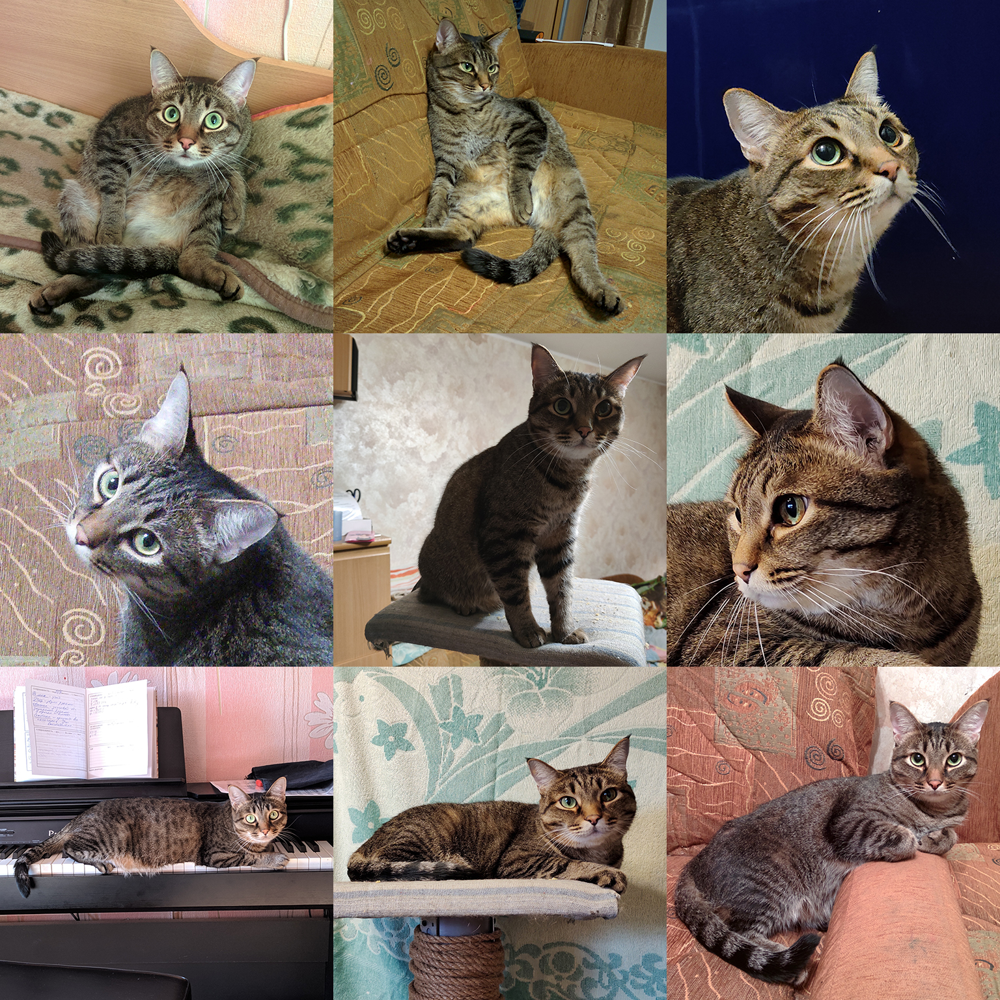

In [12]:
train_images = []
for path in os.listdir(instance_dir):
    img = Image.open(instance_dir + "/" + path)
    train_images.append(img)

image_grid(train_images, rows=3, cols=3)

In [13]:
fp_16_arg = "fp16" if FP_16 else "no"

command = (
    f'accelerate launch lora/training_scripts/train_lora_dreambooth.py '
    f'--pretrained_model_name_or_path="{pretrained_model}" '
    f'--instance_data_dir="{instance_dir}" '
    f'--output_dir="{output_dir}" '
    f'--instance_prompt="{instance_prompt}" '
    f'--resolution=512 '
    f'--use_8bit_adam '
    f'--mixed_precision={fp_16_arg} '
    f'--train_batch_size={batch_size} '
    f'--gradient_accumulation_steps=1 '
    f'--learning_rate={lr_unet} '
    f'--lr_scheduler="constant" '
    f'--lr_warmup_steps=0 '
    f'--max_train_steps={steps} '
    f'--lora_rank={lora_rank} '
    f'--seed={seed} '
    f'--save_steps=10000000 '
    f'--center_crop '
)

if train_text_encoder:
    command += (
        f'--train_text_encoder '
        f'--learning_rate_text={lr_text_encoder} '
    )

if prior_preservaion:
    command += (
        f'--with_prior_preservation '
        f'--class_prompt="{class_prompt}" '
        f'--class_data_dir="{class_dir}" '
    )

In [ ]:
!rm -rf {instance_dir}/.ipynb_checkpoints
!{command}

# Inference

In [15]:
import torch
from lora_diffusion import monkeypatch_or_replace_lora, tune_lora_scale
from diffusers import StableDiffusionPipeline

pipe = StableDiffusionPipeline.from_pretrained(pretrained_model, torch_dtype=torch.float16).to("cuda")
monkeypatch_or_replace_lora(pipe.unet, torch.load(os.path.join(output_dir, "lora_weight.pt")))
monkeypatch_or_replace_lora(pipe.text_encoder, torch.load(os.path.join(output_dir, "lora_weight.text_encoder.pt")), target_replace_module=["CLIPAttention"])
pipe.safety_checker = None

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [16]:
def get_model_inference_pipe(pipe, prompts, unet_scale=1, text_encoder_scale=1, guidance_scale=7, num_inference_steps=50, random_seed=1):
    tune_lora_scale(pipe.unet, unet_scale)
    if text_encoder_scale:
        tune_lora_scale(pipe.text_encoder, text_encoder_scale)
    generator = torch.Generator("cuda").manual_seed(random_seed)
    return pipe(prompts, num_inference_steps=num_inference_steps, guidance_scale=guidance_scale, generator=generator)

  0%|          | 0/30 [00:00<?, ?it/s]

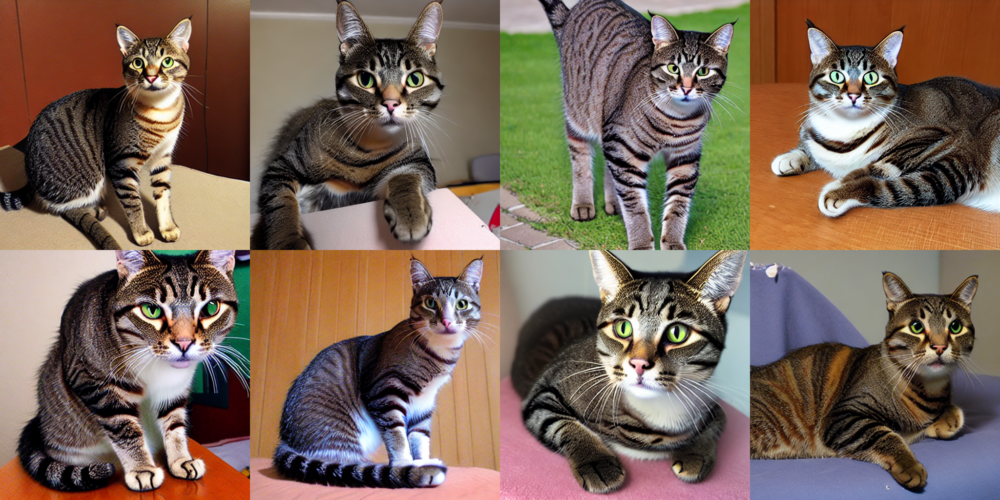

In [17]:
inference_pipe = get_model_inference_pipe(
        pipe,
        prompts=["a photo of sks cat"]*8,
        unet_scale=0.6,
        text_encoder_scale=0.8,
        guidance_scale=7,
        num_inference_steps=30,
        random_seed=1
)
image_grid(inference_pipe.images, rows=2, cols=4)

  0%|          | 0/30 [00:00<?, ?it/s]

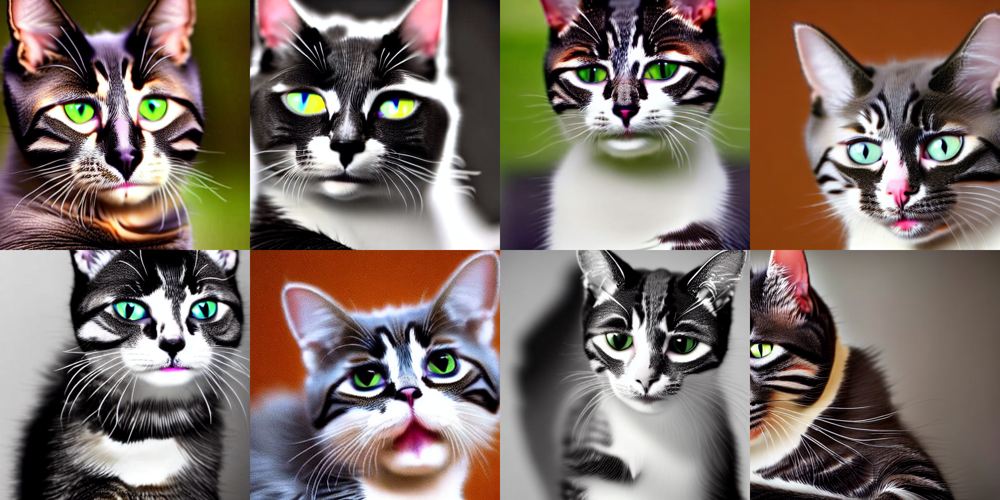

In [18]:
inference_pipe = get_model_inference_pipe(
        pipe,
        prompts=["a photo of a cat"]*8,
        unet_scale=0.6,
        text_encoder_scale=0.8,
        guidance_scale=7,
        num_inference_steps=30,
        random_seed=1
)
image_grid(inference_pipe.images, rows=2, cols=4)

  0%|          | 0/30 [00:00<?, ?it/s]

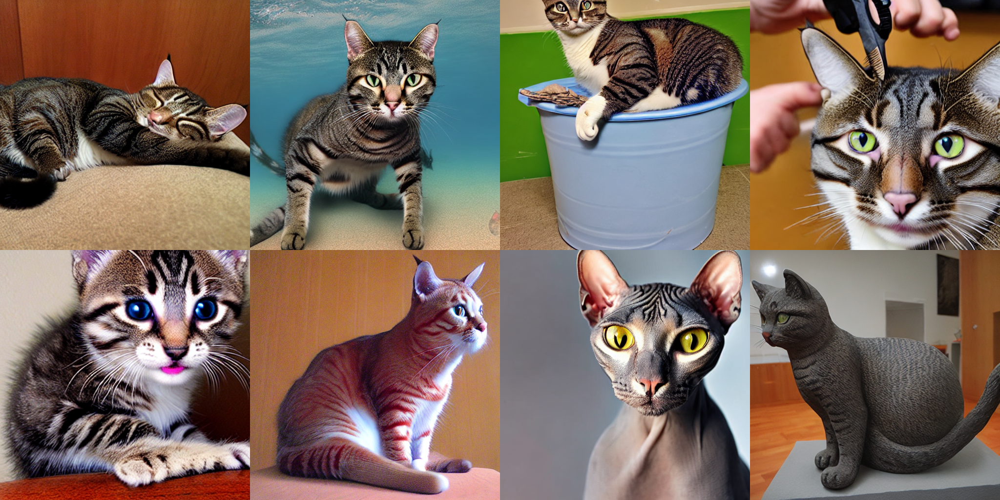

In [19]:
inference_pipe = get_model_inference_pipe(
        pipe,
        prompts=[
            "a photo of sks cat sleeping",
            "a photo of sks cat swimming",
            "a photo of sks cat in a bucket",
            "a photo of sks cat getting a haircut",
            "a photo of sks kitten",
            "a photo of sks red cat",
            "a photo of sphynx sks cat",
            "a photo of sks cat sculpture"],
        unet_scale=0.6,
        text_encoder_scale=0.8,
        guidance_scale=7,
        num_inference_steps=30,
        random_seed=1
)
image_grid(inference_pipe.images, rows=2, cols=4)

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

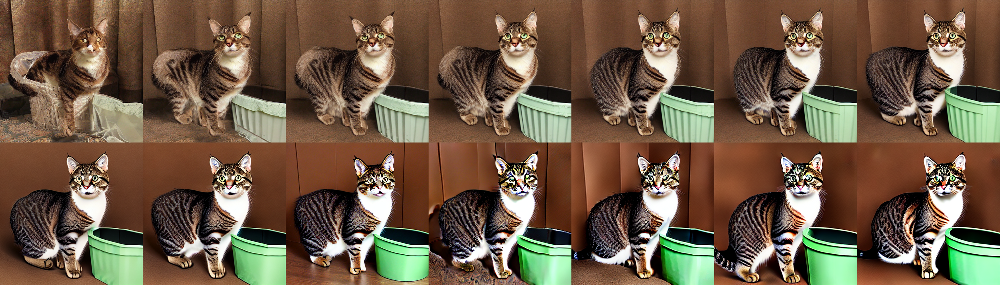

In [20]:
images_guide = []
for guidance in range(1, 15):
    inference_pipe = get_model_inference_pipe(
        pipe,
        prompts=["a photo of sks cat in a bucket"],
        unet_scale=0.6,
        text_encoder_scale=0.8,
        guidance_scale=guidance,
        num_inference_steps=30,
        random_seed=1
    )
    images_guide.append(inference_pipe.images[0])
image_grid(images_guide, rows=2, cols=7)

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

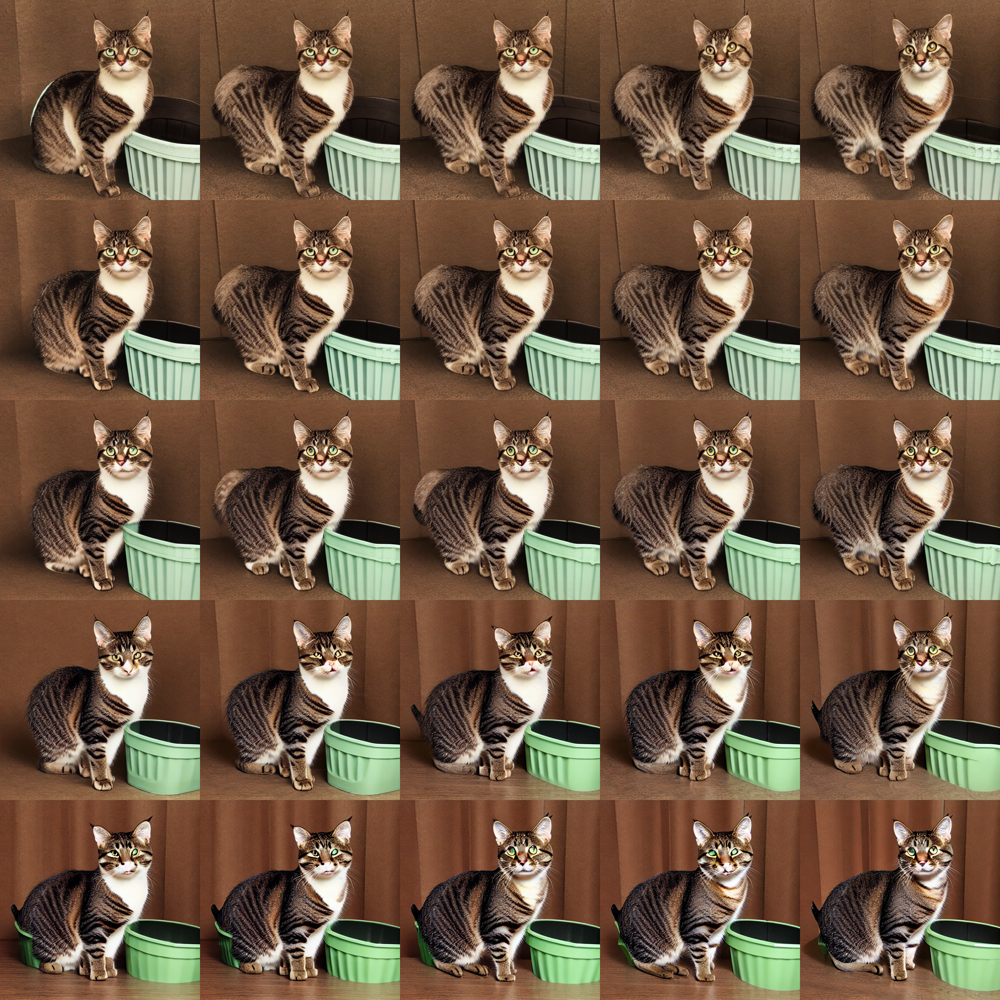

In [21]:
images_alpha = []
for a in range(1, 6):
    for b in range(1, 6):
        inference_pipe = get_model_inference_pipe(
            pipe,
            prompts=["a photo of sks cat in a bucket"],
            unet_scale=2*a/10,
            text_encoder_scale=2*b/10,
            guidance_scale=5,
            num_inference_steps=30,
            random_seed=1
        )
        images_alpha.append(inference_pipe.images[0])
image_grid(images_alpha, rows=5, cols=5)